In [135]:
import numpy as np
from scipy.linalg import expm
from scipy.optimize import least_squares
from optimizer_optimated import Optimizer
import pandas as pd


In [136]:
data_path = "/u/dem/kebl6911/Part-II/MATRICES/Ct_exc.out"

data = np.loadtxt(data_path)

t = data[:,0]
Ct = data[:,1:].reshape((-1,7,7))
Ct = np.einsum("tij->tji",Ct)

Cts = Ct[(np.arange(len(Ct)) % 10 == 0) | (np.arange(len(Ct)) == len(Ct) - 1)]
ts = t[(np.arange(len(t)) % 10 == 0) | (np.arange(len(t)) == len(t) - 1)]

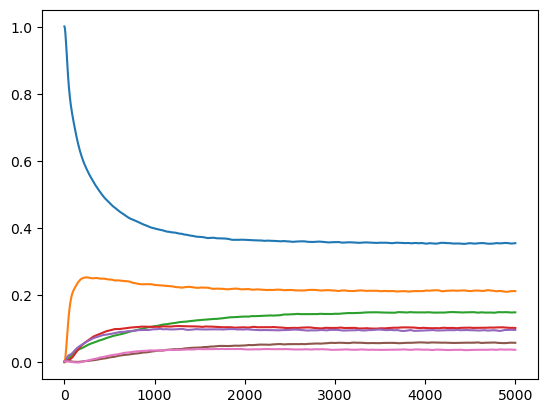

In [137]:
import matplotlib.pyplot as plt

for i in range(0,7):
    plt.plot(ts,Cts[:,i,0])


In [138]:
t_star_1 = np.where(ts == 250)[0] #currently testing
t_star_2 = np.where(ts >= 200)[0] #currently testing

print(t_star_1)
print(t_star_2[0])


ts = ts[:t_star_1[0]+1] # Include t = 500.
print(ts)
Cts = Cts[:t_star_1[0]+1]

[50]
40
[  0.   5.  10.  15.  20.  25.  30.  35.  40.  45.  50.  55.  60.  65.
  70.  75.  80.  85.  90.  95. 100. 105. 110. 115. 120. 125. 130. 135.
 140. 145. 150. 155. 160. 165. 170. 175. 180. 185. 190. 195. 200. 205.
 210. 215. 220. 225. 230. 235. 240. 245. 250.]


In [139]:
peq = Ct[-1]
peq = np.mean(peq, axis=1)

In [140]:
# column_names = ["Time"]
# data_path = "/u/dem/kebl6911/Part-II/HEOM/pop_site_tau-50_T-300_init-0_K_2_L_2.dat"

# for i in range(1,8):
#     column_names.append(str(i))
# print(column_names)
# df = pd.read_csv(data_path, delimiter=" ", names=column_names, usecols=range(len(column_names)))

# df = df[(df.index % 10 == 0) | (df.index == len(df.index) - 1)]

# # All the values within the df
# values = df.values 
# full_time = df["Time"].values
# t2 = 5000
# t3 = full_time[-1]

# #Only consider values below t2
# site_df = df[df["Time"]<=t2]
# start_to_t2= site_df.values #DF to NP

# no_states = 7
# eq_pop = values[-1]
# eq_pop = eq_pop[1:8]

# t1 = 500
# data = site_df[site_df["Time"]<=t1]
# start_to_t1= data.values #DF to NP
# # print(start_to_t1)
# # print(start_to_t1[::-1,:])

# pop = start_to_t1[:,1:8]
# print(pop.shape)

In [141]:
print(Cts[0])
print(Cts[-1])

x = Cts[::-1,:]

print(x[0])

[[ 1.00093e+00 -1.50000e-03 -1.18000e-03 -2.50000e-04 -2.30000e-04
   7.50000e-04  6.40000e-04]
 [-1.62000e-03  1.00008e+00 -1.13000e-03  5.40000e-04  7.00000e-05
  -9.50000e-04  1.70000e-04]
 [-8.30000e-04 -6.60000e-04  1.00463e+00  3.00000e-04  6.00000e-04
   2.90000e-04  4.20000e-04]
 [-1.50000e-04  7.60000e-04  5.00000e-05  1.00146e+00 -5.10000e-04
  -1.64000e-03  7.80000e-04]
 [-2.20000e-04  2.00000e-04  2.60000e-04 -6.00000e-04  9.99390e-01
  -3.40000e-04  5.80000e-04]
 [ 6.00000e-04 -9.70000e-04 -2.00000e-04 -1.89000e-03 -5.00000e-04
   9.99410e-01  3.20000e-04]
 [ 8.90000e-04  5.50000e-04  3.20000e-04  9.30000e-04  8.30000e-04
   7.20000e-04  9.98960e-01]]
[[ 0.57327  0.34685  0.08871  0.16722  0.16255  0.06801  0.08788]
 [ 0.25171  0.29274  0.06417  0.23336  0.20515  0.05339  0.13429]
 [ 0.04846  0.0552   0.57445  0.04434  0.05537  0.40882  0.05465]
 [ 0.06123  0.14496  0.01719  0.27881  0.19012  0.02143  0.15488]
 [ 0.06018  0.12212  0.02419  0.18656  0.23349  0.03602  0.2283

In [142]:
Cts = Cts[::-1]
pop = Cts
time = ts[::-1]
eq_pop = peq
ns = 7
time_size = len(time)
dt = time[1]-time[0]
print(dt)
p0 = pop[0] # population from which t*
initial_kappas = np.zeros(ns*(ns-1)//2)


-5.0


In [143]:
def listkap_matkappa(kappa):
    ''' Calculate the kappa matrix from the list of kappas.
    '''
    matkappa = np.zeros((ns,ns))
    triangle = np.triu(np.ones((ns, ns), dtype=bool), k=1)
    matkappa[triangle]= kappa
    matkappa += matkappa.T
    return matkappa

def matkappa_matr(kappa):
    ''' Calculate population propagator matrix R from a list of
        kappas.
        '''
    matkappa = listkap_matkappa(kappa)
    matr = np.zeros((ns,ns))
    matr = matkappa * eq_pop[:, np.newaxis]
    rdiag = -np.sum(matr,0)
    matr = matr + np.diag(rdiag)
    return matr

In [144]:
# # Assuming arr_zeros is an array of zeros with the desired shape (21, 7, 1)
# arr_zeros = np.zeros((21, 7, 4))

# # Assuming arr_input is a 2D array with shape (21, 7)
# arr_input = np.arange(21 * 7).reshape((21, 7))
# for i in range(arr_input.shape[0]):
#     arr_zeros[i, :, 0] = arr_input[i, :]

# print(arr_zeros)
# print(arr_input)

print(Cts[0]) #Ct at time 0
column_1 = Cts[:, :, 0] #Populations starting at site 1
print(column_1)


[[ 0.57327  0.34685  0.08871  0.16722  0.16255  0.06801  0.08788]
 [ 0.25171  0.29274  0.06417  0.23336  0.20515  0.05339  0.13429]
 [ 0.04846  0.0552   0.57445  0.04434  0.05537  0.40882  0.05465]
 [ 0.06123  0.14496  0.01719  0.27881  0.19012  0.02143  0.15488]
 [ 0.06018  0.12212  0.02419  0.18656  0.23349  0.03602  0.22839]
 [ 0.00213  0.00329  0.23643  0.00427  0.01486  0.39439  0.02655]
 [ 0.00261  0.03331 -0.0024   0.08592  0.13811  0.01619  0.31524]]
[[ 5.73270e-01  2.51710e-01  4.84600e-02  6.12300e-02  6.01800e-02
   2.13000e-03  2.61000e-03]
 [ 5.76130e-01  2.51690e-01  4.77300e-02  6.02200e-02  5.93800e-02
   2.06000e-03  2.39000e-03]
 [ 5.79020e-01  2.51600e-01  4.70200e-02  5.92600e-02  5.85100e-02
   1.98000e-03  2.21000e-03]
 [ 5.81920e-01  2.51580e-01  4.63100e-02  5.83100e-02  5.75800e-02
   1.91000e-03  1.98000e-03]
 [ 5.84980e-01  2.51470e-01  4.55500e-02  5.73300e-02  5.66800e-02
   1.89000e-03  1.69000e-03]
 [ 5.88160e-01  2.51180e-01  4.47700e-02  5.63200e-02  5.

In [145]:
print(p0[:,0])

[0.57327 0.25171 0.04846 0.06123 0.06018 0.00213 0.00261]


In [146]:
# p_model = np.zeros((time_size,ns))#create a new array filled with zeroes in the same shape as self.pop 7x7 array
# p_model[0,:] = p0[:,0] #The first 7x7 array of zeros - SOMETHING WRONG HERE?
    
# for i in range(1,time_size):   
#     p_model[i,:] = np.array([1,1,1,1,1,1,1])
#     print(p_model)

In [147]:
def p_model(exp_r_del_t,s):
    ''' Evaluate the training model.
    '''
    p_model = np.zeros((time_size,ns))#create a new array filled with zeroes in the same shape as self.pop 7x7 array
    p_model[0,:] = p0[:,s] #The first 7x7 array of zeros - SOMETHING WRONG HERE?
    print(f"p_model at {p_model} and s at {s}")
    
    for i in range(1,time_size):   
        p_model[i,:] = exp_r_del_t.dot(p_model[i-1,:])
    return p_model

In [148]:
''' Calculate the vector of residuals.
'''
# r_of_t = matkappa_matr(kappa)
# exp_r_del_t = expm(r_of_t*dt)
# residual_all = np.zeros((ns,ns*time_size))
#populations starting at site 0 i.e column 0 of all arrays

for s in range(ns):
    population = Cts[:, :, s]
    # p_model_result = p_model(exp_r_del_t,s)
    # residual = (population - p_model_result).flatten()
    # residual_all[s] = residual.flatten()
# residual_all = residual_all.flatten()

In [149]:
def residuals(kappa):
    ''' Calculate the vector of residuals.
    '''
    r_of_t = matkappa_matr(kappa)
    exp_r_del_t = expm(r_of_t*dt)
    residual_all = np.zeros((ns,ns*time_size))
    for s in range(ns):
        population = Cts[:, :, s]
        p_model_result = p_model(exp_r_del_t,s)
        residual = (population - p_model_result).flatten()
        residual_all[s] = residual.flatten()
    residual_all = residual_all.flatten()
    return residual_all

In [150]:
ls_result = least_squares(residuals,initial_kappas,bounds=(0,float("inf")))#,xtol=None,ftol=1e-8)
kappa_opt = ls_result.x
print(kappa_opt)

p_model at [[0.57327 0.25171 0.04846 0.06123 0.06018 0.00213 0.00261]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0. 

p_model at [[0.34685 0.29274 0.0552  0.14496 0.12212 0.00329 0.03331]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0.      0.     ]
 [0.      0.      0.      0.      0.      0. 

In [151]:
Cts = Ct[(np.arange(len(Ct)) % 10 == 0) | (np.arange(len(Ct)) == len(Ct) - 1)]
ts = t[(np.arange(len(t)) % 10 == 0) | (np.arange(len(t)) == len(t) - 1)]
t_predict = ts[t_star[0]+1:]
p0 = Cts[t_star[0]+1:]
p0 = p0[0]

r = matkappa_matr(kappa_opt)
dt = t_predict[1]-t_predict[0]
exp_rdt = expm(r*dt)

pop = np.zeros((len(t_predict),ns))
pop[0,:] = p0[:,0]
for i in range(1,len(t_predict)):
    pop[i,:] = exp_rdt.dot(pop[i-1,:])

print(pop.shape)
print(t_predict.shape)

(1000, 7)
(1000,)


In [157]:
zeros = np.zeros((len(t_predict),ns,ns))

print(pop[1])
zeros[:,:,0] = pop[:,:]
print(zeros)

[9.79332789e-01 1.61510872e-02 1.08613709e-03 1.39276083e-04
 1.40574917e-03 6.48553567e-04 8.26408288e-04]
[[[ 9.96520000e-01  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 1.59000000e-03  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [-4.50000000e-04  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  ...
  [ 4.80000000e-04  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 6.60000000e-04  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 8.40000000e-04  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]]

 [[ 9.79332789e-01  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 1.61510872e-02  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 1.08613709e-03  0.000000

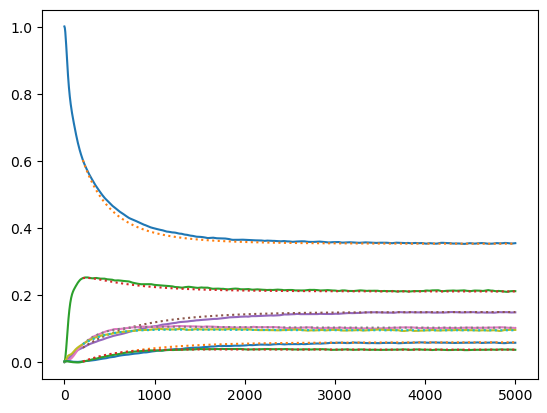

In [ ]:
import matplotlib.pyplot as plt

for i in range(0,7):
    plt.plot(ts,Cts[:,i,0])
    plt.plot(t_predict, pop[:,i],":")